# Graphs for Paper

This note book relies on the note books and scripts to be ran to generate the training data for the different experiments.

In [53]:
import numpy as np
import torch
import torch.nn as nn
from torch.autograd import Variable
import torch.backends.cudnn as cudnn
import torchvision

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torchvision.utils import save_image

width = 64
height = 64
channels = 3


if torch.cuda.is_available():
    device = torch.device("cuda:0")
    # work on a single GPU or CPU
    cudnn.benchmark=True
    #generator.cuda()
    #discriminator.cuda()
    #adversarial_loss.cuda()
    Tensor = torch.cuda.FloatTensor
    print(device)

cuda:0


In [9]:
class Generator(nn.Module):
    def __init__(self, latent_dim):
        super(Generator, self).__init__()
        
        # First, transform the input into a 8x8 256-channels feature map
        self.init_size = width // 16  # one 16th the image size 
        self._latent_dim = latent_dim
        self.l1 = nn.Sequential(
            nn.Linear(self._latent_dim, 64), nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(64, 128), nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(128, 256 * self.init_size ** 2), nn.LeakyReLU(0.2, inplace=True), # 4X4
        )
        
        self.conv_blocks = nn.Sequential(
            #input 256 X init_size X init_size
            
            ############# 4x4 #########################################
            
            nn.BatchNorm2d(256), 
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1), #8X8
            nn.LeakyReLU(0.2, inplace=True),
            
            ############# 8X8 #########################################
            
            nn.BatchNorm2d(128), 
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1), #16X16
            nn.LeakyReLU(0.2, inplace=True),
            
            ############# 16X16 #########################################
            
            nn.BatchNorm2d(64), 
            nn.ConvTranspose2d(64, 32, 4, stride=2, padding=1), #32X32
            nn.LeakyReLU(0.2, inplace=True),
            
            ############# 32X32 #########################################
            
            nn.BatchNorm2d(32), 
            nn.ConvTranspose2d(32, 16, 4, stride=2, padding=1), #64X64
            nn.LeakyReLU(0.2, inplace=True),
            
            ############# 64X64 #########################################
            
            # Produce a 32x32xRGB-channel feature map
            nn.Conv2d(16, channels, kernel_size=3, padding='same'),
            nn.Tanh(),
        )
        
    def forward(self, z):
        
        # expand the sampled z to 8x8
        out = self.l1(z)
        
        out = torch.reshape(out, (out.shape[0], 256, self.init_size, self.init_size))
        
        # use the view function to reshape the layer output
        #  old way for earlier Torch versions: out = out.view(out.shape[0], 128, self.init_size, self.init_size)
        img = self.conv_blocks(out)
        return img

In [10]:
class Discriminator(nn.Module):

    def __init__(self, latent_dim):
        super(Discriminator, self).__init__()
        
        self.init_size = width // 16 # one 16th the image size 
        self._latent_dim = latent_dim

        self.model = nn.Sequential(
            
            ############# 64X64 #########################################
            nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding='same'), #64X64
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(16, 0.8),
            
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=4, stride=2, padding=1), #32X32
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(32, 0.8),
            
            ############# 32X32 #########################################
            
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1), #16X16
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(64, 0.8),
            
            ############# 16X16 #########################################
            
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1), #8x8
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(128, 0.8),
            
            ############# 8X8 #########################################
            
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1), #4X4
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(256, 0.8),
            
            ############# 4x4 #########################################
            
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(256, 0.8),
        )
        
        # laten_dim_layer layer
        self.laten_dim_layer = nn.Sequential(nn.Linear(256 * self.init_size ** 2, 128), nn.LeakyReLU(0.2, inplace=True),
                                             nn.Linear(128, 64), nn.LeakyReLU(0.2, inplace=True),
                                             nn.Linear(64, self._latent_dim), nn.LeakyReLU(0.2, inplace=True),
                                            )
        # Classification layer
        self.classification_layer = nn.Sequential(nn.Linear(self._latent_dim, 1), 
                                                  nn.Sigmoid())
    def forward(self, img):
        
        out = self.model(img)
        # use the view function to flatten the layer output
        #    old way for earlier Torch versions: out = out.view(out.shape[0], -1)
        out = torch.flatten(out, start_dim=1) # don't flatten over batch size
        
        # move to the latent dim
        out = self.laten_dim_layer(out)
        
        #validate the latent dim
        validity = self.classification_layer(out)
        return validity


In [11]:
def load_checkpoint(file_prefix, gen_func, disc_func):
    # load up checkpoint images from previous runs ls_images_dog.npy
    ims = np.load(f'models/gan_models/{file_prefix}_images_celeb.npy')

    #np.save(f'models/gan_models/{setback_name}_is_scores_celeb.npy', IS_scores)
    is_score = np.load(f'models/gan_models/{file_prefix}_is_scores_celeb.npy')
    
    generator = gen_func(100) # create generator (no weights)
    discriminator = disc_func(100) # create disciminator (no weights)

    # now populate the weights from a previous training
    print(f'models/gan_models/{file_prefix}_gen.pth')
    checkpoint = torch.load(f'models/gan_models/{file_prefix}_gen_celeb.pth')
    generator.load_state_dict(checkpoint['state_dict'])

    checkpoint = torch.load(f'models/gan_models/{file_prefix}_dis_celeb.pth')
    discriminator.load_state_dict(checkpoint['state_dict'])
    
    return ims, generator, discriminator, is_score

In [33]:
def plot_is_score(scores_labels):

    colors = ['r', 'b', 'g', 'c', 'm', 'y', 'k']
    plt.figure(figsize=(12.8,4.8))
    for i, (score, label) in enumerate(scores_labels):
        epochs = range(1, len(score) + 1)
        plt.plot(epochs,  score, colors[i], label=f'Inception Score: {label}', )
    plt.title('Inception*')
    plt.legend()
    plt.show()

In [37]:
ims_ls, gen_ls, disc_ls, is_score_ls = load_checkpoint('ls', Generator, Discriminator)
ims_sb50_25, gen_sb50_25, disc_sb50_25, is_score_sb50_25 = load_checkpoint('setback_50_0.25', Generator, Discriminator)
ims_sb50_50, gen_sb50_50, disc_sb50_50, is_score_sb50_50 = load_checkpoint('setback_50_0.5', Generator, Discriminator)

models/gan_models/ls_gen.pth
models/gan_models/setback_50_0.25_gen.pth
models/gan_models/setback_50_0.5_gen.pth


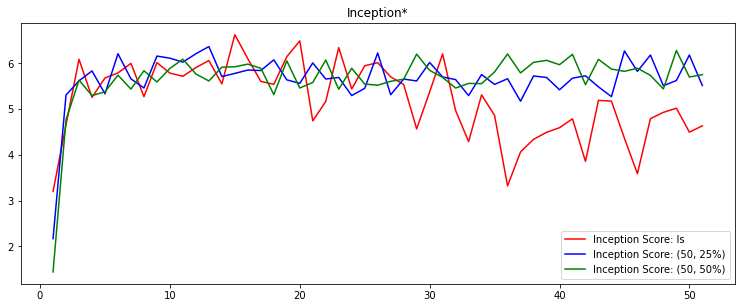

In [39]:
plot_is_score(
    [
        (is_score_ls, 'ls'),
        (is_score_sb50_25, '(50, 25%)'),
        (is_score_sb50_50, '(50, 50%)')
    ])

In [71]:
def norm_grid(im):
    # first half should be normalized and second half also, separately
    im = im.astype(np.float)
    rows,cols,chan = im.shape
    cols_over2 = int(cols/2)
    tmp = im[:,:cols_over2,:]
    im[:,:cols_over2,:] = (tmp-tmp.min())/(tmp.max()-tmp.min())
    tmp = im[:,cols_over2:,:]
    im[:,cols_over2:,:] = (tmp-tmp.min())/(tmp.max()-tmp.min())
    return im

In [68]:
def imshow(img, title=''):
    # custom show in order to display
    # torch tensors as numpy
    npimg = img.numpy() / 2 + 0.5 # from tensor to numpy
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.title(title, fontsize=100)
    plt.axis('off')
    plt.show()
    
def plot_100(generator, latent_dim=100, count=100, random_latent_vectors=None, title=''):
    # Sample Vectors
    latent_dim = 100
    if random_latent_vectors is None:
        random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (100, latent_dim)))).detach().cpu()

    # Generate images from sampled vectors
    gen_ims_ls = generator(random_latent_vectors)

    plt.figure(figsize=(40,40))
    imshow(torchvision.utils.make_grid(gen_ims_ls[0:100], padding=2, normalize=False, nrow=10).cpu(), title=title)

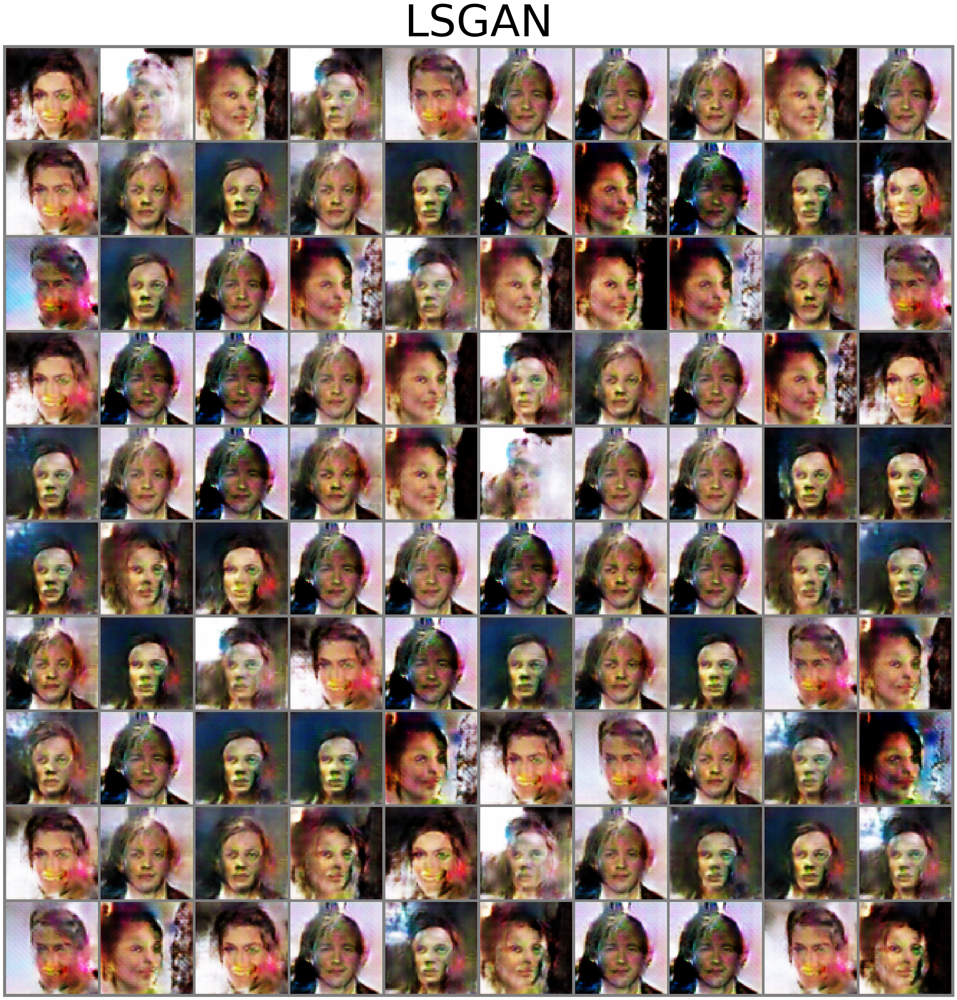

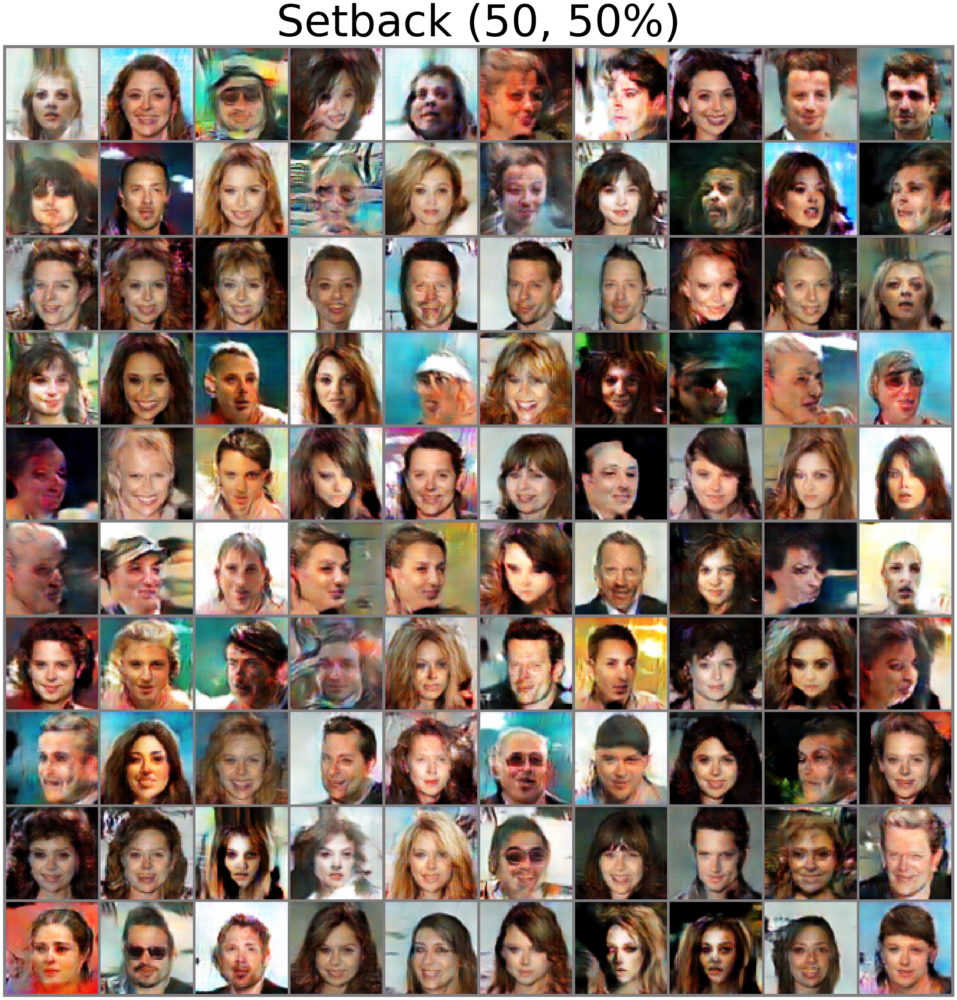

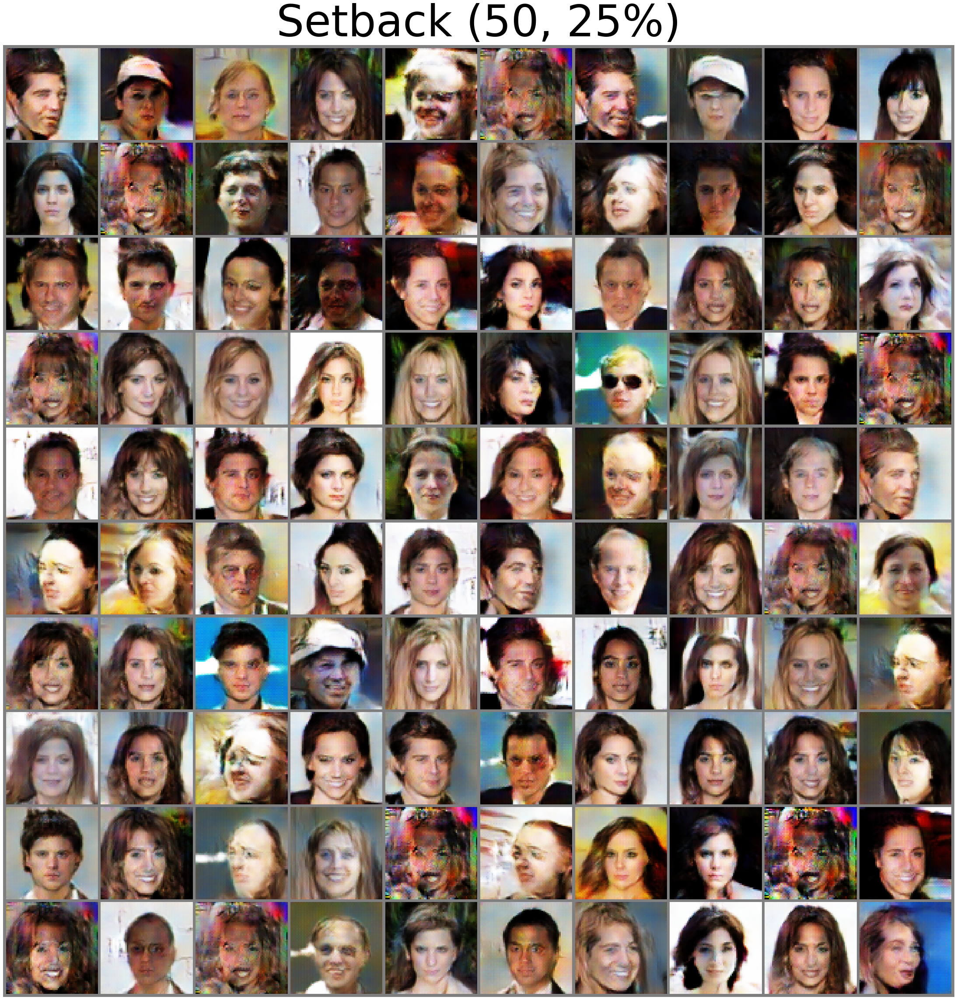

In [69]:
random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (100, latent_dim)))).detach().cpu()
plot_100(gen_ls, random_latent_vectors=random_latent_vectors, title='LSGAN')
plot_100(gen_sb50_50, random_latent_vectors=random_latent_vectors, title=f'Setback (50, 50%)')
plot_100(gen_sb50_25, random_latent_vectors=random_latent_vectors, title=f'Setback (50, 25%)')

# LSGAN Progression

/tmp/ipykernel_633500/682364400.py:3: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  im = im.astype(np.float)


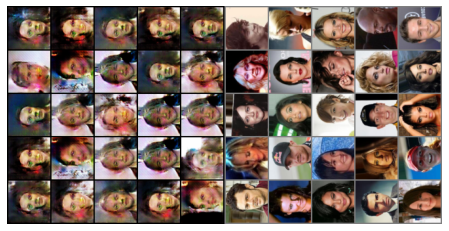

In [72]:
fig = plt.figure(figsize=(12,4))
plt.axis("off")  
pls = [[plt.imshow(norm_grid(im), animated=True)] for im in ims_ls]
ani = animation.ArtistAnimation(fig, pls, interval=500, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

# Setback 50, 0.25

/tmp/ipykernel_633500/682364400.py:3: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  im = im.astype(np.float)


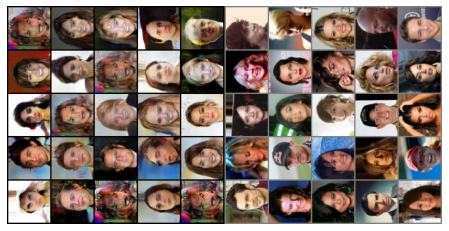

In [73]:
fig = plt.figure(figsize=(12,4))
plt.axis("off")  
pls = [[plt.imshow(norm_grid(im), animated=True)] for im in ims_sb50_25]
ani = animation.ArtistAnimation(fig, pls, interval=500, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())